In [2]:
from brainvistools import tvbplot
import numpy as np
from matplotlib.tri import Triangulation
import pandas as pd
import numpy.linalg as npl

import hcp_utils as hcp
import nibabel as nib
from nilearn.plotting.surf_plotting import _set_view_plot_surf_matplotlib

from tvbase import constants
from nilearn import plotting

from scipy import io

import matplotlib.pyplot as plt
import matplotlib.patches as mpatches


pixdim[1,2,3] should be non-zero; setting 0 dims to 1
/Users/leonmartin_bih/opt/anaconda3/lib/python3.9/site-packages/nilearn/input_data/__init__.py:27: FutureWarning: The import path 'nilearn.input_data' is deprecated in version 0.9. Importing from 'nilearn.input_data' will be possible at least until release 0.13.0. Please import from 'nilearn.maskers' instead.
  warnings.warn(message, FutureWarning)


In [3]:
import matplotlib.pyplot as plt
import seaborn as sns

from matplotlib.lines import Line2D


In [4]:
sub_cols = '#ef476f #ffd166 #06d6a0 #118ab2 #073b4c'.split(' ')

In [5]:
mmp1 = nib.load('/Users/leonmartin_bih/work_data/Virtual-DBS/normative-connectome/dsi_hcp_MMP1.nii')

centers_hcp = plotting.find_parcellation_cut_coords(mmp1)

In [6]:
area_info = pd.read_csv('/Users/leonmartin_bih/work_data/Virtual-DBS/normative-connectome/output_minimal/Glasser+Distal+Striatum_AreaInfo.csv', index_col=0)
dbs_centers = list()
for i, r in area_info.iterrows():
    dbs_centers.append([r.center_x, r.center_y, r.center_z])

In [7]:
dbs_sc = io.loadmat('/Users/leonmartin_bih/Downloads/hcp_whole_brain_MMP-Distal-Striatum_enpoints_counts.mat')['connectivity']

# centers_txt = '/Users/leonmartin_bih/work_data/Virtual-DBS/normative-connectome/output/Glasser+Distal_centers.txt'
# dbs_centers = np.loadtxt(centers_txt)

# centers_txt_hcp = '/Users/leonmartin_bih/work_data/TVBase/tvbase-python/tvbase/dependencies/tvbase_atlas_mni_center_coordinates.txt'

# hcp_centers = np.loadtxt(centers_txt_hcp)

dbs_centers[:360] = centers_hcp[:360]
dbs_centers = np.array(dbs_centers)

sc_dict = list()
sc_dict_sub = list()

for ind_i, i in enumerate(dbs_sc):
    for ind_j, j in enumerate(i):
        center_j = dbs_centers[ind_j]
        center_i = dbs_centers[ind_i]

        x = np.array((center_j[0], center_i[0]))
        y = np.array((center_j[1], center_i[1]))
        z = np.array((center_j[2], center_i[2]))
        
        if j > 0 and ind_i < 180 and ind_j < 180:
            sc_dict.append({'x':x, 'y':y, 'z':z, 'weight':j})

        if j > 0 and ind_i >= 360 and ind_i < 365 and ind_j < 180:
            sc_dict_sub.append({'x':x, 'y':y, 'z':z, 'weight':j, 'color':sub_cols[ind_i-360]})
            print(area_info.iloc[ind_i].label)
            print(ind_i-360)




# for ind_i, i in enumerate(dbs_sc[360:365, :180]):
#     for ind_j, j in enumerate(i):
#         center_j = dbs_centers[ind_j+360]
#         center_i = dbs_centers[ind_i+360]

#         x = np.array((center_j[0], center_i[0]))
#         y = np.array((center_j[1], center_i[1]))
#         z = np.array((center_j[2], center_i[2]))
        
#         if j > 0:
#             sc_dict_sub.append({'x':x, 'y':y, 'z':z, 'weight':j})

Subthalamic Nucleus
0
Subthalamic Nucleus
0
Subthalamic Nucleus
0
Subthalamic Nucleus
0
Subthalamic Nucleus
0
Subthalamic Nucleus
0
Subthalamic Nucleus
0
Subthalamic Nucleus
0
Subthalamic Nucleus
0
Subthalamic Nucleus
0
Subthalamic Nucleus
0
Subthalamic Nucleus
0
Subthalamic Nucleus
0
Subthalamic Nucleus
0
Subthalamic Nucleus
0
Subthalamic Nucleus
0
Subthalamic Nucleus
0
Subthalamic Nucleus
0
Subthalamic Nucleus
0
Subthalamic Nucleus
0
Subthalamic Nucleus
0
Subthalamic Nucleus
0
Subthalamic Nucleus
0
Subthalamic Nucleus
0
Subthalamic Nucleus
0
Subthalamic Nucleus
0
Subthalamic Nucleus
0
Subthalamic Nucleus
0
Subthalamic Nucleus
0
Subthalamic Nucleus
0
Subthalamic Nucleus
0
Internal Pallidum
1
Internal Pallidum
1
Internal Pallidum
1
Internal Pallidum
1
Internal Pallidum
1
Internal Pallidum
1
Internal Pallidum
1
Internal Pallidum
1
Internal Pallidum
1
Internal Pallidum
1
Internal Pallidum
1
Internal Pallidum
1
Internal Pallidum
1
Internal Pallidum
1
Internal Pallidum
1
Internal Pallidum


In [8]:
dbs_sc.shape

(370, 370)

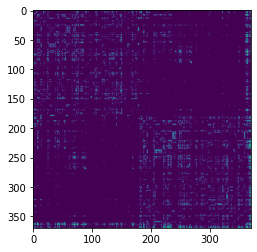

In [9]:
plt.imshow(np.log1p(dbs_sc))

In [10]:
t1 = constants.mni09c_brain
mni_aff = t1.affine

In [11]:
atlas_colors = hcp.mmp['rgba']

atlas_info = pd.read_csv('../data/HCP-MMP1_UniqueRegionList.csv')

# centers = list()

# for i, r in atlas_info.iterrows():
#     real_pt = nib.affines.apply_affine(mni_aff, [r['x-cog'], r['y-cog'], r['z-cog']])
#     centers.append(real_pt)

In [12]:
import tvbase

# admap = tvbase.map_scaiview('MESH:D000544', request_doclist=False)


In [13]:
from tvbase import plot, reparc

# data = reparc.parc_data2fsaverage(admap.parc_data)
# data = hcp.unparcellate(admap.parc_data, hcp.mmp)
# data = hcp.left_cortex_data(data)

(<Figure size 1440x1440 with 1 Axes>, <AxesSubplot:>)

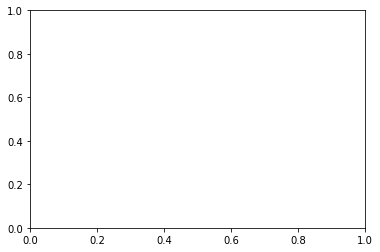

In [14]:
import nibabel as nib

vtx, tri = nib.freesurfer.read_geometry(
    "/Applications/freesurfer/6/subjects/fsaverage/surf/lh.pial"
)

gii = nib.load('/Users/leonmartin_bih/work_data/BrainAtlases/Glasser/Glasser_et_al_2016_HCP_MMP1.0_kN_RVVG/HCP_PhaseTwo/Q1-Q6_RelatedValidation210/MNINonLinear/fsaverage_LR32k/Q1-Q6_RelatedValidation210.L.pial_MSMAll_2_d41_WRN_DeDrift.32k_fs_LR.surf.gii')
vtx, tri = gii.agg_data()

gii_rh = nib.load('/Users/leonmartin_bih/work_data/BrainAtlases/Glasser/Glasser_et_al_2016_HCP_MMP1.0_kN_RVVG/HCP_PhaseTwo/Q1-Q6_RelatedValidation210/MNINonLinear/fsaverage_LR32k/Q1-Q6_RelatedValidation210.R.pial_MSMAll_2_d41_WRN_DeDrift.32k_fs_LR.surf.gii')
vtx_rh, tri_rh = gii_rh.agg_data()

# vtx_rh, tri_rh = nib.freesurfer.read_geometry(
#     "/Applications/freesurfer/6/subjects/fsaverage/surf/rh.pial"
# )



tvbplot.plot_surface_mpl(
    vtx=vtx,
    tri=tri,
    # data=data,
    reorient="fs",
    view='superior',
    shade_kwargs={"edgecolors": "white", "linewidth": 10**-10, 'alpha':.5},
    figsize=(20, 20),
)

# for i, (x, y, z) in enumerate(centers):
#     fig.axes[0].scatter(x,y,z, color=atlas_colors[i])

In [21]:
def legend_circles(labels, palette, loc=1, markersize=10, marker='o', padding=0):
    "Make a legend where the color is indicated by a circle."
    legend_markers = [Line2D(range(1), range(1),
                             linewidth=0,   # Invisible line
                             marker=marker,
                             markersize=markersize,
                             markerfacecolor=palette[i],
                             markeredgecolor=palette[i]) for i in range(len(labels))]
    
    legend_markers.append(Line2D(range(1), range(1),
                             linewidth=0,   # Invisible line
                             marker='s',
                             markersize=markersize,
                             markerfacecolor='white',
                             markeredgecolor='grey'))
    labels.append('Glasser areas')
    
    return plt.legend(legend_markers, labels, numpoints=1, bbox_to_anchor=(0.9, 0.3))

In [22]:
import matplotlib as mpl
mpl.rcParams["figure.dpi"] = 1000

In [34]:
%matplotlib inline

data = None

import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib.ticker import LinearLocator
import numpy as np

hemi = 'left'
view = 'lateral'

figure = plt.figure(figsize=(10,10))
axes = figure.add_axes((0, 0, 1, 1), projection="3d")

coords = vtx
limits = [coords.min(), coords.max()]
axes.set_xlim(*limits)
axes.set_ylim(*limits)

#set view
axes.view_init(elev=0, azim=0, roll=10)


axes.set_axis_off()

# axes.dist = 8

for i, (x, y, z) in enumerate(dbs_centers[:180]):
    axes.scatter(x,y,z, color=atlas_colors[i], s=100, alpha=.5, marker='s')

# subcortex
for i, (x, y, z) in enumerate(dbs_centers[360:365]):
    axes.scatter(x,y,z, color=sub_cols[i], s=200,)

# cortical connectivity
for entry in sc_dict:
    axes.plot(entry['x'], entry['y'], entry['z'], '--',
              c='grey', 
              alpha=np.log(1+entry['weight'])/20,#np.log(1+entry['weight'])*10**-2,
              linewidth=np.log(1+entry['weight'])*10**-1
              )

# subcortical-cortical connectivity
for entry in sc_dict_sub:
    if entry['color'] == sub_cols[0]:
        axes.plot(entry['x'], entry['y'], entry['z'], c=entry['color'], alpha=np.log(1+entry['weight'])/10, linewidth=np.log(1+entry['weight']))
        # (entry['weight']/np.average(dbs_sc))*10**-1.8


axes.plot_trisurf(coords[:, 0], coords[:, 1], coords[:, 2],triangles=tri, antialiased=False, edgecolor='k', facecolor='white', alpha=.1, linewidth=10**-8, color='grey')

# handles = list()
# for i in range(5):
#     handles.append(mpatches.Patch(color=sub_cols[i], label=area_info[360:365].label.to_list()[i], hatch='o'))

# plt.legend(handles=handles, prop={"size": 10}, )
legend = legend_circles(area_info[360:365].label.to_list(),sub_cols,loc=0)


# axes.plot_trisurf(vtx_rh[:, 0], vtx_rh[:, 1], vtx_rh[:, 2],triangles=tri_rh, antialiased=False, edgecolor='k', facecolor='white', alpha=.1, linewidth=.0000001, color='grey')


# axes.imshow(t1.get_fdata()[:,:,59], cmap='Greys')
figure.set_dpi(1000)

In [24]:
figure.savefig('/Users/leonmartin_bih/work_data/Virtual-DBS/normative-connectome/revised_results/connectivity_hcp+STN-ctx.png', dpi=1000, bbox_inches='tight')

In [18]:
(entry['weight'])/np.average(dbs_sc)

4.7475104

(array([176.,   1.,   2.,   0.,   0.,   0.,   0.,   0.,   0.,   1.]),
 array([   0. ,  817.5, 1635. , 2452.5, 3270. , 4087.5, 4905. , 5722.5,
        6540. , 7357.5, 8175. ]),
 <BarContainer object of 10 artists>)

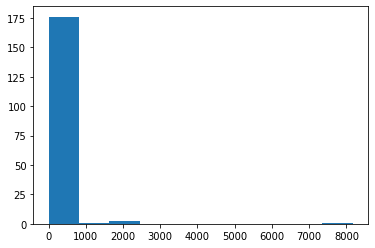

In [19]:
area_info.iloc[360]
plt.hist(dbs_sc[360, :180])

In [20]:
# figure = plt.figure(figsize=(10,10))
# ax = figure.add_axes((0, 0, 1, 1), projection="3d")
# ax.set_xlim(-200,200)
# ax.set_ylim(-200,200)
# ax.set_zlim(-200,200)

# ax.imshow(t1.get_fdata()[:,10,:], cmap='gray', origin='lower', alpha=0.3)